In [1]:
import matplotlib.pyplot as plt
import numpy as np
import os
import cv2
import pandas as pd
import seaborn as sns
import sklearn 
# import metric
import umap
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
import sklearn.cluster as cluster
import torch

# Loss analysis

In [2]:
rootdir = '/gpfsscratch/rech/ohv/ueu39kt/TumorNoTumor_fromMNISTMDN2_res'
lossfile = 'loss.csv'

In [3]:
df_loss = pd.read_csv(os.path.join(rootdir, lossfile), header = None, sep='\t')

In [4]:
df_loss.head()

,0,1,2,3
0,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0.079078,0.755213,182.398926
1,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0.079078,0.755213,182.398926
2,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0.079078,0.755213,182.398926
3,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0.079078,0.755213,182.398926
4,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0.079078,0.755213,182.398926


In [5]:
df_loss.shape

(29908291, 4)

In [6]:

df_loss =  df_loss.drop_duplicates()

In [7]:
df_loss.shape

(280280, 4)

In [7]:
# df_loss.to_csv('/gpfswork/rech/ohv/ueu39kt/TumorNoTumor_fromMNISTMDN2/loss_clean.csv')

In [8]:
df_loss_sample = df_loss

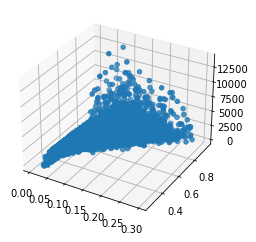

In [9]:


fig = plt.figure()
ax = plt.axes(projection='3d')
ax.scatter(
    df_loss_sample.iloc[:, 1],
    df_loss_sample.iloc[:, 2],
    df_loss_sample.iloc[:, 3]
)

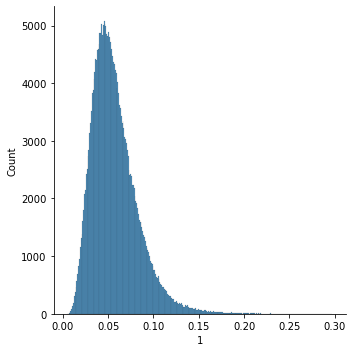

In [10]:
sns.displot(df_loss_sample.iloc[:, 1])

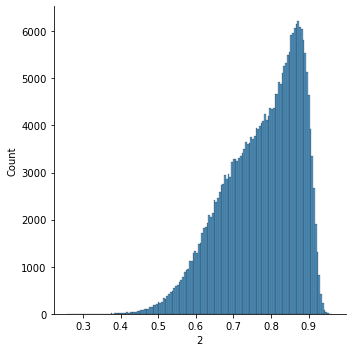

In [11]:
sns.displot(df_loss_sample.iloc[:, 2])

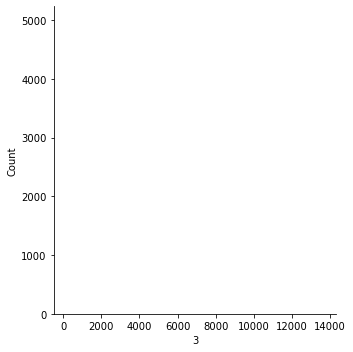

In [12]:
sns.displot(df_loss_sample.iloc[:, 3])

In [15]:
min(df_loss_sample.iloc[:, 3].values)

180.7607421875

In [16]:
max(df_loss_sample.iloc[:, 3].values)

13645.44140625

In [10]:
clean_loss = pd.read_csv('/gpfsscratch/rech/ohv/ueu39kt/TumorNoTumor_fromMNISTMDN2_res/lossclean.csv', header = None)

In [11]:
clean_loss.shape

(174080, 2)

In [12]:
clean_loss.head(20)

,0,1
0,0,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...
1,1,0.0309576820582151
2,2,0.6815332174301147
3,3,182.84780883789065
4,0,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...
5,1,0.0899836868047714
6,2,0.7351042628288269
7,3,185.0355987548828
8,0,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...
9,1,0.0604355558753013


In [13]:
filename = [] 
loss1 = []
loss2 = []
loss3 = []
for i in range(clean_loss.shape[0]):
    if clean_loss.iloc[i,0] == 0:
        filename.append(clean_loss.iloc[i,1])
    elif clean_loss.iloc[i,0] == 1:
        loss1.append(clean_loss.iloc[i,1])
    elif clean_loss.iloc[i,0] == 2:
        loss2.append(clean_loss.iloc[i,1])
    elif clean_loss.iloc[i,0] == 3:
        loss3.append(clean_loss.iloc[i,1])


In [14]:

clean_loss_df  = pd.DataFrame()
clean_loss_df['filename'] =filename
clean_loss_df['loss1'] =loss1
clean_loss_df['loss2'] =loss2
clean_loss_df['loss3'] =loss3

In [15]:
clean_loss_df

,filename,loss1,loss2,loss3
0,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0.0309576820582151,0.6815332174301147,182.84780883789065
1,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0.0899836868047714,0.7351042628288269,185.0355987548828
2,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0.0604355558753013,0.7357013821601868,182.3316650390625
3,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0.0274134632200002,0.6722496747970581,184.91770935058597
4,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0.036496601998806,0.6677917242050171,185.2243194580078
...,...,...,...,...
43515,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0.0531960986554622,0.8560324311256409,183.57595825195312
43516,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0.0462158732116222,0.7474308609962463,185.58297729492188
43517,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0.0792584642767906,0.8254526853561401,183.8802490234375
43518,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0.0477086715400218,0.8813320398330688,183.55935668945312


<IPython.core.display.Javascript object>


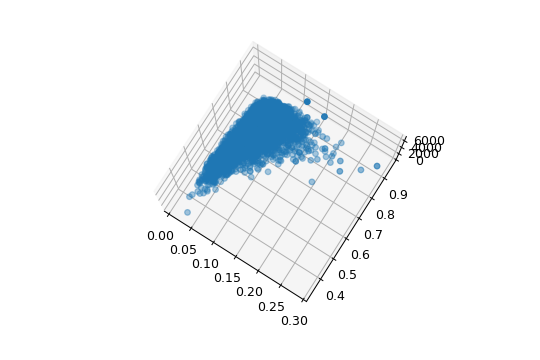

In [104]:
%matplotlib notebook

fig = plt.figure()
ax = plt.axes(projection='3d')
ax.scatter(
    clean_loss_df.iloc[:, 1],
    clean_loss_df.iloc[:, 2],
    clean_loss_df.iloc[:, 3],
     marker='o',

)

In [103]:
clean_loss_df.head()

,filename,loss1,loss2,loss3
0,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0.030958,0.681533,182.847809
1,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0.089984,0.735104,185.035599
2,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0.060436,0.735701,182.331665
3,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0.027413,0.672250,184.917709
4,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0.036497,0.667792,185.224319


In [63]:
len(set(clean_loss_df['filename']))

5430

In [89]:
 clean_loss_df.iloc[:, 1:] =  clean_loss_df.iloc[:, 1:].astype(np.float64)

In [93]:
clean_loss_df.iloc[:, 2]

0       0.681533
1       0.735104
2       0.735701
3        0.67225
4       0.667792
          ...   
5425    0.734438
5426    0.667616
5427     0.87068
5428    0.610636
5429    0.833905
Name: loss2, Length: 5430, dtype: object

In [16]:
clean_loss_df = df_loss
clean_loss_df = clean_loss_df.rename(columns ={0:'filename',
                                     1:'loss1',
                                     2:'loss2',
                                     3:'loss3'})
clean_loss_df.head()

,filename,loss1,loss2,loss3
0,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0.079078,0.755213,182.398926
107,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0.079078,0.755213,182.398926
214,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0.101770,0.826670,182.909790
320,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0.062778,0.877227,182.836929
425,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0.096400,0.905437,185.810303


In [17]:

clean_loss_df["loss1"] = pd.to_numeric(clean_loss_df["loss1"], downcast="float")

In [18]:
clean_loss_df["loss2"] = pd.to_numeric(clean_loss_df["loss2"], downcast="float")
clean_loss_df["loss3"] = pd.to_numeric(clean_loss_df["loss3"], downcast="float")

In [19]:
sample = []
for i in range(clean_loss_df.shape[0]):
    sample.append(clean_loss_df.iloc[i,0].split('/')[-3])

In [20]:
clean_loss_df['sample'] = sample

In [21]:
set(clean_loss_df['sample'])

{'TNE0001',
 'TNE0002',
 'TNE0003',
 'TNE0004',
 'TNE0005',
 'TNE0006',
 'TNE0007',
 'TNE0008',
 'TNE0009',
 'TNE0011',
 'TNE0015',
 'TNE0016',
 'TNE0017',
 'TNE0018',
 'TNE0019',
 'TNE0025',
 'TNE0027',
 'TNE0028',
 'TNE0031',
 'TNE0033',
 'TNE0034',
 'TNE0056',
 'TNE0057',
 'TNE0058',
 'TNE0060',
 'TNE0061',
 'TNE0066',
 'TNE0067',
 'TNE0069',
 'TNE0071',
 'TNE0072',
 'TNE0073',
 'TNE0075',
 'TNE0077',
 'TNE0078',
 'TNE0079',
 'TNE0080',
 'TNE0081',
 'TNE0117',
 'TNE0180',
 'TNE0181',
 'TNE0227',
 'TNE0228',
 'TNE0229',
 'TNE0230',
 'TNE0231',
 'TNE0232',
 'TNE0233',
 'TNE0234',
 'TNE0235',
 'TNE0263',
 'TNE0277',
 'TNE0278',
 'TNE0286',
 'TNE0287',
 'TNE0288',
 'TNE0289',
 'TNE0305',
 'TNE0306',
 'TNE0308',
 'TNE0340',
 'TNE0341',
 'TNE0360',
 'TNE0387',
 'TNE0390',
 'TNE0403',
 'TNE0404',
 'TNE0405',
 'TNE0406',
 'TNE0407',
 'TNE0408',
 'TNE0416',
 'TNE0417',
 'TNE0450',
 'TNE0451',
 'TNE0452',
 'TNE0477',
 'TNE0478',
 'TNE0479',
 'TNE0480',
 'TNE0484',
 'TNE0485',
 'TNE0486',
 'TN

In [22]:
for s in set(clean_loss_df['sample']):
    print(s,clean_loss_df[clean_loss_df['sample'] == s].shape[0] )

TNE0077 486
TNE1102 536
TNE0531 1890
TNE0520 933
TNE0491 681
TNE1026 212
TNE1023 112
TNE0530 1551
TNE0305 416
TNE0017 133
TNE0944 641
TNE0880 620
TNE1444 795
TNE0959 286
TNE0568 3187
TNE1408 528
TNE1011 174
TNE1013 94
TNE2112 620
TNE0484 841
TNE0567 2889
TNE0795 248
TNE1002 522
TNE0061 544
TNE0227 127
TNE1419 758
TNE0403 1618
TNE1413 891
TNE0898 902
TNE0979 1241
TNE2127 1131
TNE0859 104
TNE0018 726
TNE1079 474
TNE1024 102
TNE0889 190
TNE1508 798
TNE0525 2298
TNE0949 668
TNE0954 489
TNE1101 1204
TNE1411 186
TNE0002 105
TNE1430 1121
TNE1424 139
TNE0406 800
TNE0019 57
TNE1410 705
TNE0034 91
TNE0503 1103
TNE0058 503
TNE0027 1119
TNE0798 867
TNE0078 164
TNE0893 331
TNE0878 832
TNE2150 708
TNE1426 649
TNE1350 4
TNE1418 363
TNE2155 610
TNE0574 4041
TNE1433 799
TNE1078 248
TNE2097 471
TNE0477 2729
TNE0575 1850
TNE1020 45
TNE0016 152
TNE0936 1283
TNE0963 774
TNE0589 3381
TNE0988 927
TNE0536 1302
TNE2122 615
TNE0234 1365
TNE1428 306
TNE0866 546
TNE1406 254
TNE0526 3170
TNE1458 182
TNE1089 1078
T

In [93]:
clean_loss_df_TNE0589= clean_loss_df[clean_loss_df['sample'] == 'TNE0570']

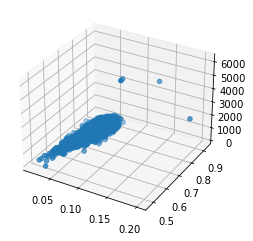

In [30]:
%matplotlib inline

fig = plt.figure()
ax = plt.axes(projection='3d')
ax.scatter(
    clean_loss_df_TNE0589.iloc[:, 1],
    clean_loss_df_TNE0589.iloc[:, 2],
    clean_loss_df_TNE0589.iloc[:, 3],
     marker='o',

)

In [94]:
clean_loss_df_TNE0589.iloc[:,1:3]

,loss1,loss2,loss3
10595,0.034691,0.633149,186.772369
19073,0.020636,0.564812,187.211395
40380,0.055895,0.787626,182.631912
44620,0.064670,0.738094,182.735123
75661,0.071148,0.728085,182.669373
...,...,...,...
29859446,0.065032,0.813611,182.580215
29868877,0.082719,0.792056,185.713593
29877139,0.028301,0.605682,183.627197
29886570,0.051709,0.739589,183.541138


In [97]:
kmeans_labels = cluster.KMeans(n_clusters=2).fit_predict(clean_loss_df_TNE0589.iloc[:,1:3])

In [99]:
from sklearn.cluster import DBSCAN

In [114]:
DBSCAN_labels = DBSCAN(eps=0.01, min_samples=10).fit_predict(clean_loss_df_TNE0589.iloc[:,1:3])

In [115]:
set(DBSCAN_labels)

{-1, 0}

Text(0, 0.5, 'SSIM')

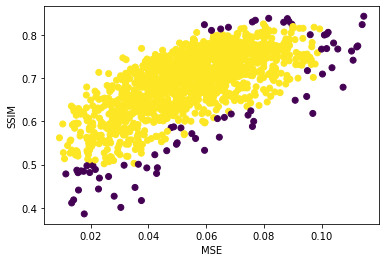

In [116]:


fig = plt.figure()
plt.scatter(
    clean_loss_df_TNE0589.iloc[:, 1],
    clean_loss_df_TNE0589.iloc[:, 2],
     marker='o',
c = DBSCAN_labels,
label = DBSCAN_labels)
plt.xlabel('MSE')
plt.ylabel('SSIM')


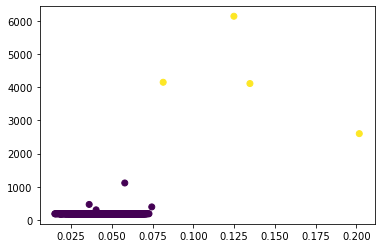

In [62]:
fig = plt.figure()
plt.scatter(
    clean_loss_df_TNE0589.iloc[:, 1],
    clean_loss_df_TNE0589.iloc[:, 3],
     marker='o',
c = kmeans_labels,
label = kmeans_labels)


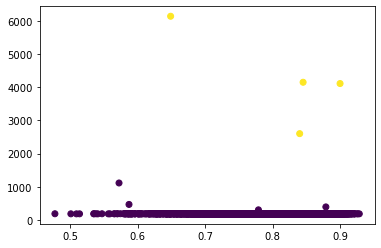

In [63]:
fig = plt.figure()
plt.scatter(
    clean_loss_df_TNE0589.iloc[:, 2],
    clean_loss_df_TNE0589.iloc[:, 3],
     marker='o',
c = kmeans_labels,
label = kmeans_labels)

In [118]:
clean_loss_df_TNE0589['Kmeans'] = DBSCAN_labels

/gpfslocalsup/pub/anaconda-py3/2020.02/envs/pytorch-gpu-1.7.1/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [119]:
def tiles_in_cluster(cluster_number , clustering_df, ascending=True ):
    '''clustering_df : contain filename '''
    clusteremd_x = clustering_df[clustering_df['Kmeans'] == cluster_number] # purple
    clusteremd_x = clusteremd_x.sort_values(by ='loss3',axis= 0, ascending=ascending) # left extremity purple
    # left extremity yellow cluster
    c  = 0 
    fig, axs = plt.subplots(2,10, figsize=(19, 4), facecolor='w', edgecolor='k')
    fig.subplots_adjust(hspace =0, wspace=0)
    row2 = False
    for ele in clusteremd_x['filename'][0:20]:
        try:
            im = cv2.imread(ele)
            im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
            if row2 == False:
                if c < 10:
                    axs[0,c].imshow(im)
                    axs[0,c].axis('off')
                    c+=1
                elif c == 10:
                    c = 0 
                    row2 = True
                    axs[1,c].imshow(im)
                    axs[1,c].axis('off')
                    c +=1

            else:
                axs[1,c].imshow(im)
                axs[1,c].axis('off')
                c+=1
        except:
            print(ele)


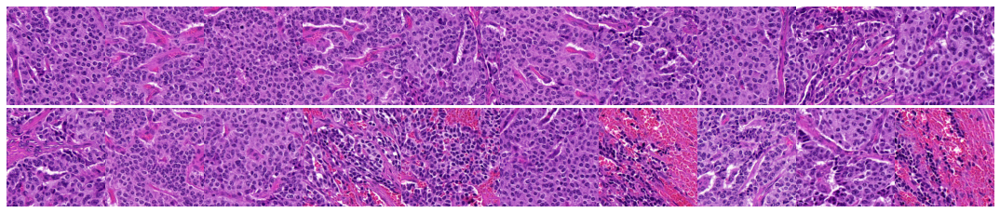

In [120]:
tiles_in_cluster(0 , clean_loss_df_TNE0589, ascending=True )

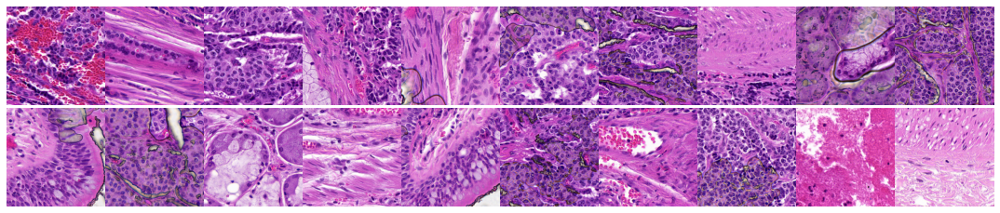

In [122]:
tiles_in_cluster(-1 , clean_loss_df_TNE0589, ascending=True )

In [68]:
clean_loss_df_TNE0589 = clean_loss_df_TNE0589[clean_loss_df_TNE0589['loss1'] < 0.06]

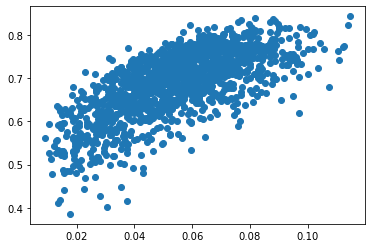

In [123]:
plt.scatter(
    clean_loss_df_TNE0589.iloc[:, 1],
    clean_loss_df_TNE0589.iloc[:, 2],
     marker='o',
)

In [51]:
kmeans_labels = cluster.KMeans(n_clusters=8).fit_predict(clean_loss_df_TNE0589.iloc[:,1:4])

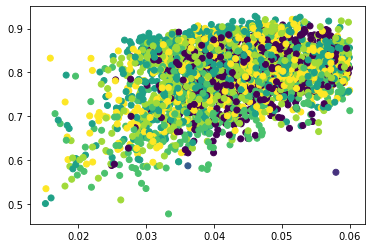

In [52]:
fig = plt.figure()
plt.scatter(
    clean_loss_df_TNE0589.iloc[:, 1],
    clean_loss_df_TNE0589.iloc[:, 2],
     marker='o',
c = kmeans_labels,
label = kmeans_labels)

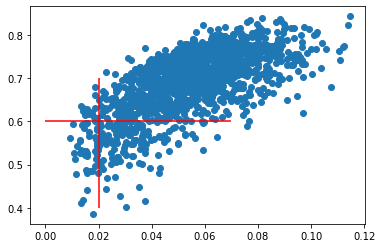

In [125]:
plt.scatter(
   clean_loss_df_TNE0589.iloc[:, 1],
    clean_loss_df_TNE0589.iloc[:, 2],

)
plt.vlines(x = 0.02, ymin = 0.4, ymax = 0.7, colors = 'r')
plt.hlines(y = 0.6, xmin = 0.0, xmax = 0.07, colors = 'r')

In [126]:
lc= list(set(clean_loss_df_TNE0589[(clean_loss_df_TNE0589.iloc[:,1] <= 0.025) & (clean_loss_df_TNE0589.iloc[:,2] <= 0.6) ].iloc[:,0].values))
lc

['/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0570/accept/TNE0570_39271_107647.jpg',
 '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0570/accept/TNE0570_51283_60985.jpg',
 '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0570/accept/TNE0570_33265_43891.jpg',
 '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0570/accept/TNE0570_53131_82699.jpg',
 '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0570/accept/TNE0570_53593_74383.jpg',
 '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0570/accept/TNE0570_33727_103489.jpg',
 '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0570/accept/TNE0570_54517_77617.jpg',
 '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0570/accept/TNE0570_15247_89629.jpg',
 '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0570/accept/TNE0570_53131_74845.jpg',

In [127]:
def plot10Tiles(list_tiles):
    c  = 0 
    fig, axs = plt.subplots(2,5, figsize=(19, 4), facecolor='w', edgecolor='k')
    fig.subplots_adjust(hspace =0, wspace=0)
    row2 = False
    for ele in list_tiles:
        try:
            im = cv2.imread(ele)
            im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
            if row2 == False:
                if c < 5:
                    axs[0,c].imshow(im)
                    axs[0,c].axis('off')
                    c+=1
                elif c == 5:
                    c = 0 
                    row2 = True
                    axs[1,c].imshow(im)
                    axs[1,c].axis('off')
                    c +=1

            else:
                axs[1,c].imshow(im)
                axs[1,c].axis('off')
                c+=1
        except:
            print(ele)

/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0570/accept/TNE0570_52669_74845.jpg
/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0570/accept/TNE0570_42043_98869.jpg
/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0570/accept/TNE0570_14785_42967.jpg
/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0570/accept/TNE0570_9703_93325.jpg
/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0570/accept/TNE0570_16633_41119.jpg
/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0570/accept/TNE0570_38809_43891.jpg
/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0570/accept/TNE0570_33265_105799.jpg
/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0570/accept/TNE0570_11551_45277.jpg
/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0570/accept/TNE0570_13399_97483.jpg
/gpfsscratch/rech/ohv/ueu39kt/Tiles_5

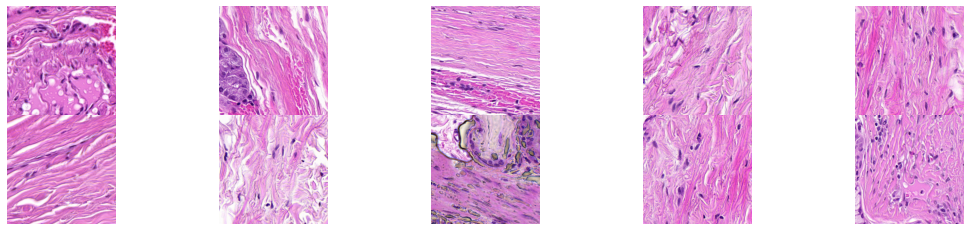

In [128]:
plot10Tiles(lc[:20])

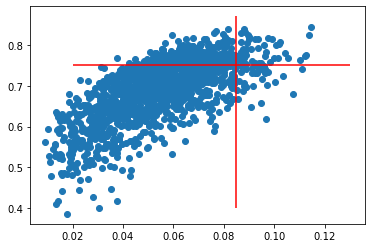

In [136]:
plt.scatter(
   clean_loss_df_TNE0589.iloc[:, 1],
    clean_loss_df_TNE0589.iloc[:, 2],

)
plt.vlines(x = 0.085, ymin = 0.4, ymax = 0.87, colors = 'r')
plt.hlines(y = 0.75, xmin = 0.02, xmax = 0.13, colors = 'r')

In [137]:
trc= list(set(clean_loss_df_TNE0589[(clean_loss_df_TNE0589.iloc[:,1] >= 0.085) & (clean_loss_df_TNE0589.iloc[:,2] >= 0.75) ].iloc[:,0].values))
trc

['/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0570/accept/TNE0570_24025_69763.jpg',
 '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0570/accept/TNE0570_13861_59137.jpg',
 '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0570/accept/TNE0570_14323_58675.jpg',
 '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0570/accept/TNE0570_33727_71611.jpg',
 '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0570/accept/TNE0570_16171_59599.jpg',
 '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0570/accept/TNE0570_27259_69763.jpg',
 '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0570/accept/TNE0570_14323_59137.jpg',
 '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0570/accept/TNE0570_43891_75769.jpg',
 '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0570/accept/TNE0570_31417_73921.jpg',
 

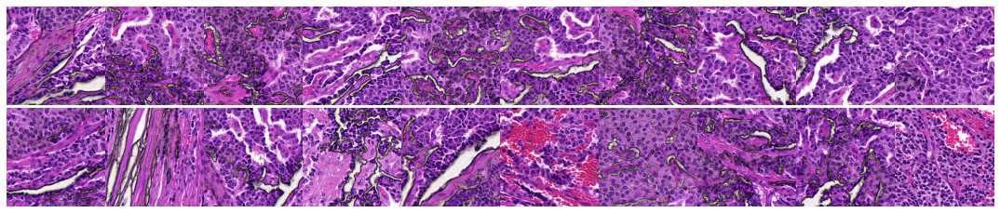

In [138]:
plot20Tiles(trc[:20])

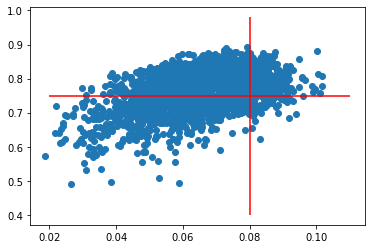

In [54]:
plt.scatter(
   clean_loss_df_TNE0589.iloc[:, 1],
    clean_loss_df_TNE0589.iloc[:, 2],

)
plt.vlines(x = 0.08, ymin = 0.4, ymax = 0.98, colors = 'r')
plt.hlines(y = 0.75, xmin = 0.02, xmax = 0.11, colors = 'r')

In [55]:
rc= list(set(clean_loss_df_TNE0589[(clean_loss_df_TNE0589.iloc[:,1] >= 0.08) & (clean_loss_df_TNE0589.iloc[:,2] >= 0.75) ].iloc[:,0].values))


In [56]:
def plot20Tiles(list_tiles):
    c  = 0 
    fig, axs = plt.subplots(2,10, figsize=(19, 4), facecolor='w', edgecolor='k')
    fig.subplots_adjust(hspace =0, wspace=0)
    row2 = False
    for ele in list_tiles:
        try:
            im = cv2.imread(ele)
            im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
            if row2 == False:
                if c < 10:
                    axs[0,c].imshow(im)
                    axs[0,c].axis('off')
                    c+=1
                elif c == 10:
                    c = 0 
                    row2 = True
                    axs[1,c].imshow(im)
                    axs[1,c].axis('off')
                    c +=1

            else:
                axs[1,c].imshow(im)
                axs[1,c].axis('off')
                c+=1
        except:
            print(ele)

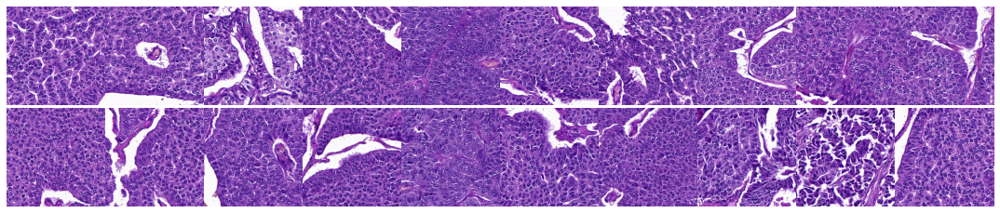

In [57]:
plot20Tiles(rc[:20])

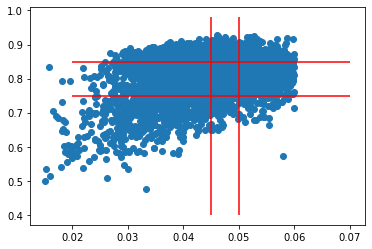

In [68]:
plt.scatter(
   clean_loss_df_TNE0589.iloc[:, 1],
    clean_loss_df_TNE0589.iloc[:, 2],

)
plt.vlines(x = 0.05, ymin = 0.4, ymax = 0.98, colors = 'r')
plt.hlines(y = 0.75, xmin = 0.02, xmax = 0.07, colors = 'r')


plt.vlines(x = 0.045, ymin = 0.4, ymax = 0.98, colors = 'r')
plt.hlines(y = 0.85, xmin = 0.02, xmax = 0.07, colors = 'r')

In [70]:
Cencter = list(set(clean_loss_df_TNE0589[(clean_loss_df_TNE0589.iloc[:,1] <= 0.05) 
                                         &(clean_loss_df_TNE0589.iloc[:,1] >= 0.045) 
                                         & (clean_loss_df_TNE0589.iloc[:,2] >= 0.75)
                                        & (clean_loss_df_TNE0589.iloc[:,2] <= 0.85)
                                        ].iloc[:,0].values))
Cencter

['/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0589/accept/TNE0589_30031_95173.jpg',
 '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0589/accept/TNE0589_46663_112729.jpg',
 '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0589/accept/TNE0589_17095_103951.jpg',
 '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0589/accept/TNE0589_19405_77155.jpg',
 '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0589/accept/TNE0589_33265_89629.jpg',
 '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0589/accept/TNE0589_55441_101179.jpg',
 '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0589/accept/TNE0589_41581_108571.jpg',
 '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0589/accept/TNE0589_35113_92863.jpg',
 '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0589/accept/TNE0589_21253_86395.jpg

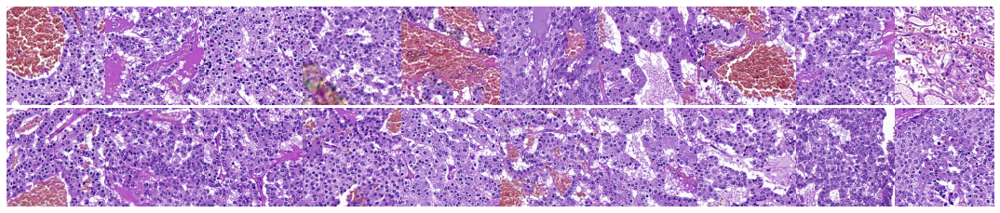

In [71]:
plot20Tiles(Cencter[:20])

In [154]:
clean_loss_df_TNE0589["loss2"] = pd.to_numeric(clean_loss_df_TNE0589["loss2"], downcast="float")
clean_loss_df_TNE0589["loss3"] = pd.to_numeric(clean_loss_df_TNE0589["loss3"], downcast="float")
clean_loss_df_TNE0589["loss1"] = pd.to_numeric(clean_loss_df_TNE0589["loss1"], downcast="float")

/gpfslocalsup/pub/anaconda-py3/2020.02/envs/pytorch-gpu-1.7.0/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.
/gpfslocalsup/pub/anaconda-py3/2020.02/envs/pytorch-gpu-1.7.0/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/gpfslocalsup/pub/anaconda-py3/2020.02/envs/pytorch-gpu-1.7.0/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A

In [4]:
umap_img  = 'embedding_umap_vector.png'
im = cv2.imread(os.path.join(rootdir, umap_img))

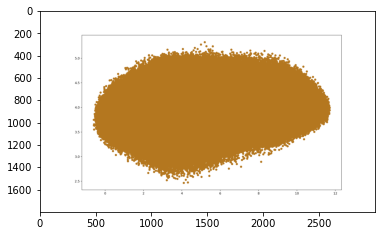

In [5]:
plt.imshow(im)

In [6]:
df_umap = pd.read_csv(os.path.join(rootdir, 'umap_emd.csv'))
df_umap.shape

(282208, 4)

In [20]:
df_vector = pd.read_csv(os.path.join(rootdir, 'vectors10x.aa'), header = None)


In [21]:
df_vector.head()

,0,1,2,3,4,5,6,7,8,9,...,991,992,993,994,995,996,997,998,999,1000
0,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,-0.295540,0.028943,-0.159135,-0.087192,-0.187859,-0.139868,-0.063913,0.014075,0.105995,...,-0.072336,-0.022674,-0.030275,-0.187369,-0.063654,-0.145280,0.026727,-0.132156,-0.164256,-0.130775
1,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,-0.084368,-0.184393,-0.059632,-0.035989,-0.220613,-0.076003,-0.167612,-0.042010,-0.069439,...,-0.163355,-0.062570,-0.091870,-0.266686,-0.197771,-0.095900,-0.147697,-0.030225,-0.010040,-0.049305
2,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,-0.213336,-0.019208,-0.171488,-0.065505,-0.045191,0.030080,-0.250975,0.044690,-0.143060,...,0.019674,-0.214161,-0.120552,-0.049738,-0.117119,-0.195508,-0.054039,-0.116439,-0.204074,-0.271727
3,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,-0.144503,-0.190440,-0.197352,-0.254690,-0.199086,-0.084981,-0.064264,-0.039873,-0.167722,...,0.028317,-0.232305,-0.129512,-0.127532,-0.189660,-0.182899,-0.265576,-0.011866,-0.155340,-0.376894
4,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,-0.020915,-0.236224,-0.141520,-0.041089,-0.160709,-0.046866,-0.265188,-0.053537,-0.163527,...,-0.172387,-0.223123,-0.209396,-0.016890,-0.264537,-0.114066,-0.090141,-0.110278,0.047146,-0.230411


In [22]:
df_vector = df_vector.drop_duplicates(subset=0)

In [23]:
df_vector.shape

(6415, 1001)

In [24]:
df_vector_values = df_vector.iloc[:5000 ,1:]

scaled_dfvector_data = StandardScaler().fit_transform(df_vector_values)
scaled_dfvector_data = pd.DataFrame(scaled_dfvector_data)
reducer = umap.UMAP()
embedding = reducer.fit_transform(scaled_dfvector_data.values)

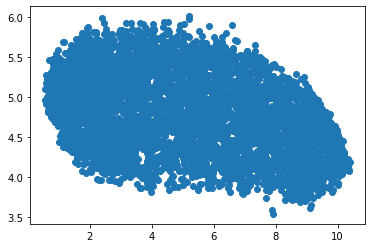

In [25]:
plt.scatter(
    embedding[:, 0],
    embedding[:, 1])

In [26]:
embedding = pd.DataFrame(embedding)
embedding['filename'] = df_vector.iloc[:,0]

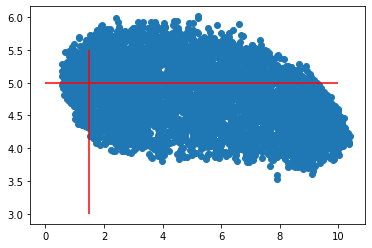

In [32]:
plt.scatter(
   embedding.iloc[:, 0],
    embedding.iloc[:, 1],

)
plt.vlines(x = 1.5, ymin = 3, ymax = 5.5, colors = 'r')
plt.hlines(y = 5, xmin = 0, xmax = 10, colors = 'r')


In [28]:
embedding.head()

,0,1,filename
0,0.853224,4.883594,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...
1,2.410123,5.199125,NaN
2,2.364465,3.957375,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...
3,1.853603,5.513435,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...
4,2.272036,4.210852,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...


In [33]:
blc= list(set(embedding[(embedding.iloc[:,0] <= 1.5) & (embedding.iloc[:,1]<= 5) ].iloc[:,2].values))
blc

['/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0563/accept/TNE0563_14323_103951.jpg',
 nan,
 '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE1430/accept/TNE1430_60985_15709.jpg',
 '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0286/accept/TNE0286_5545_80851.jpg',
 '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0806/accept/TNE0806_71149_85009.jpg',
 '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0961/accept/TNE0961_8317_6469.jpg',
 '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0075/accept/TNE0075_91477_12937.jpg',
 '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0491/accept/TNE0491_42967_24487.jpg',
 '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0576/accept/TNE0576_27259_89629.jpg',
 '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE1026/accept/TNE1026_88705_14785.jpg

nan


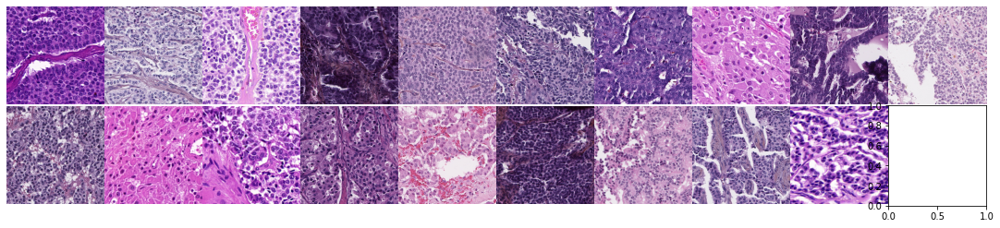

In [34]:
plot20Tiles(blc[:20])

In [35]:
ruc= list(set(embedding[(embedding.iloc[:,0] >= 8) & (embedding.iloc[:,1]>= 4.5) ].iloc[:,2].values))
ruc

[nan,
 '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0529/accept/TNE0529_19405_68839.jpg',
 '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0233/accept/TNE0233_91477_50821.jpg',
 '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0495/accept/TNE0495_4159_83161.jpg',
 '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0567/accept/TNE0567_77617_63757.jpg',
 '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0028/accept/TNE0028_40657_11089.jpg',
 '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0181/accept/TNE0181_29107_6931.jpg',
 '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0478/accept/TNE0478_34651_75307.jpg',
 '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0529/accept/TNE0529_33265_54517.jpg',
 '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0494/accept/TNE0494_20791_57289.jpg

nan


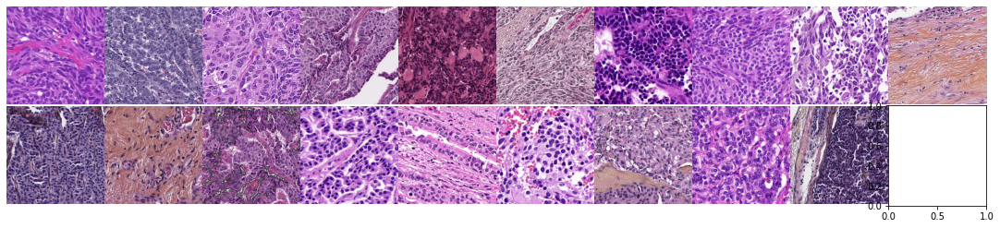

In [36]:
plot20Tiles(ruc[:20])

In [99]:
reducer = umap.UMAP(n_components = 3)
embedding = reducer.fit_transform(scaled_dfvector_data.values)

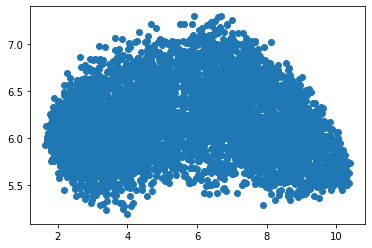

In [100]:
plt.scatter(
    embedding[:, 0],
    embedding[:, 1])

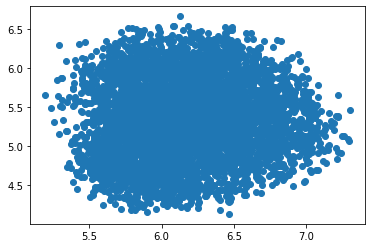

In [101]:
plt.scatter(
    embedding[:, 1],
    embedding[:, 2])

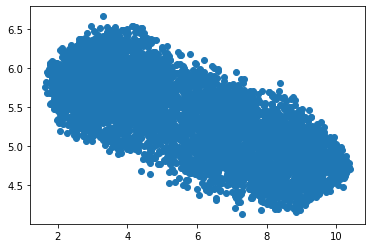

In [102]:
plt.scatter(
    embedding[:, 0],
    embedding[:, 2])

In [103]:
from sklearn.decomposition import PCA
pca = PCA(n_components=3)#
pca.fit(scaled_dfvector_data)
print(pca.explained_variance_ratio_)

[0.09034484 0.00669896 0.00633115]


In [104]:
PCA_Array = pca.transform(scaled_dfvector_data)

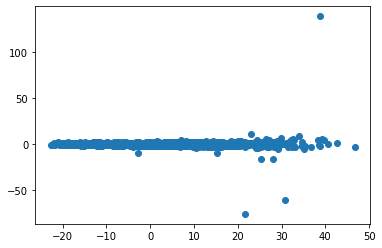

In [105]:
plt.scatter(
    PCA_Array[:, 0],
    PCA_Array[:, 1])

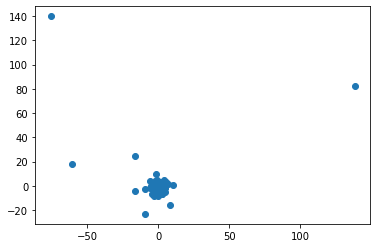

In [106]:
plt.scatter(
    PCA_Array[:, 1],
    PCA_Array[:, 2])

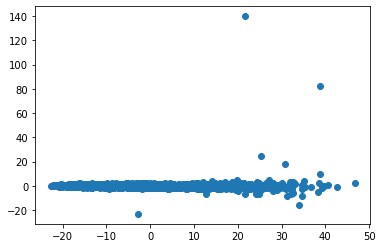

In [107]:
plt.scatter(
    PCA_Array[:, 0],
    PCA_Array[:, 2])

In [108]:
PCA_Array = pd.DataFrame(PCA_Array)

In [109]:
PCA_Array['filename']  = df_vector.iloc[:5000 ,0]

In [110]:
PCA_Array.sort_values(by =  0,axis= 0, ascending=False).iloc[:3,-1].values

array(['/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0493/accept/TNE0493_7855_86395.jpg',
       '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0806/accept/TNE0806_72073_55441.jpg',
       '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0997/accept/TNE0997_12937_6007.jpg'],
      dtype=object)

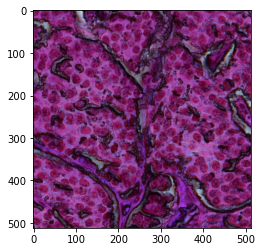

In [74]:
im =  cv2.imread('/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0568/accept/TNE0568_42505_67453.jpg')
plt.imshow(im)

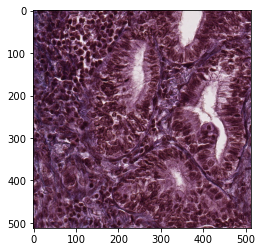

In [75]:
im =  cv2.imread('/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0806/accept/TNE0806_91477_77617.jpg')
plt.imshow(im)

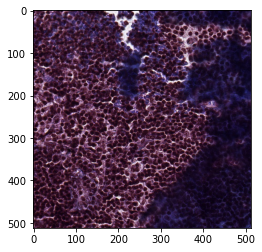

In [70]:
im =  cv2.imread('/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE2142/accept/TNE2142_79465_37885.jpg')
plt.imshow(im)

In [111]:
PCA_Array.sort_values(by =  1,axis= 0, ascending=False).iloc[:3,-1].values

array(['/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE1408/accept/TNE1408_33265_25873.jpg',
       '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0564/accept/TNE0564_18019_41581.jpg',
       '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0033/accept/TNE0033_23101_41581.jpg'],
      dtype=object)

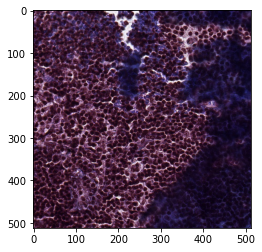

In [77]:
im =  cv2.imread('/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE2142/accept/TNE2142_79465_37885.jpg')
plt.imshow(im)

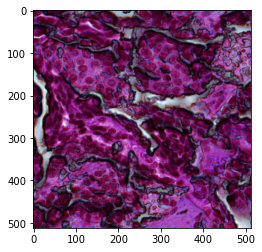

In [78]:
im =  cv2.imread('/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0568/accept/TNE0568_42043_77155.jpg')
plt.imshow(im)

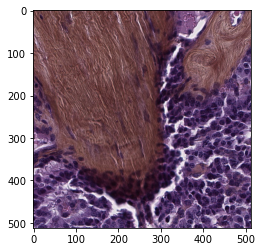

In [80]:
im =  cv2.imread('/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0798/accept/TNE0798_71149_12013.jpg')
im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
plt.imshow(im)

In [81]:
PCA_Array.sort_values(by =  2,axis= 0, ascending=False).iloc[:3,-1].values

array(['/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE2127/accept/TNE2127_63757_13861.jpg',
       '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0794/accept/TNE0794_49897_49897.jpg',
       '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE2142/accept/TNE2142_79465_37885.jpg'],
      dtype=object)

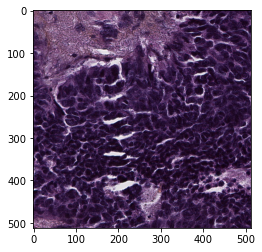

In [82]:
im =  cv2.imread('/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE2127/accept/TNE2127_63757_13861.jpg')
im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
plt.imshow(im)

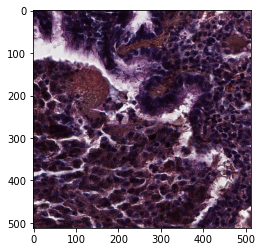

In [83]:
im =  cv2.imread('/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0794/accept/TNE0794_49897_49897.jpg')
im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
plt.imshow(im)

In [112]:
file_to_del  = [
   '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE2142/accept/TNE2142_79465_37885.jpg',
    '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0568/accept/TNE0568_42043_77155.jpg',
    '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0798/accept/TNE0798_71149_12013.jpg',
    
    '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE2127/accept/TNE2127_63757_13861.jpg',
       '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0794/accept/TNE0794_49897_49897.jpg',
    
       '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0568/accept/TNE0568_42505_67453.jpg',
       '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0806/accept/TNE0806_91477_77617.jpg',
    '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE1408/accept/TNE1408_33265_25873.jpg',
       '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0564/accept/TNE0564_18019_41581.jpg',
       '/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0033/accept/TNE0033_23101_41581.jpg'
]

In [113]:
df_vector = df_vector.loc[df_vector.iloc[:,0].isin(file_to_del) ==  False,:]

In [114]:
df_vector_values = df_vector.iloc[:5000 ,1:]
scaled_dfvector_data = StandardScaler().fit_transform(df_vector_values)
scaled_dfvector_data = pd.DataFrame(scaled_dfvector_data)
pca.fit(scaled_dfvector_data)
print(pca.explained_variance_ratio_)

[0.09035742 0.00669826 0.00633088]


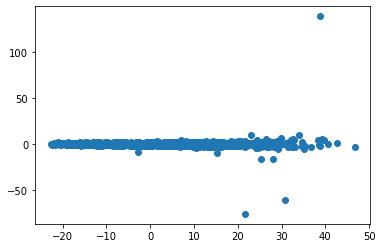

In [115]:
PCA_Array = pca.transform(scaled_dfvector_data)
plt.scatter(
    PCA_Array[:, 0],
    PCA_Array[:, 1])

In [117]:
kmeans_labels = cluster.KMeans(n_clusters=4).fit_predict(PCA_Array)

In [121]:
type(PCA_Array)

pandas.core.frame.DataFrame

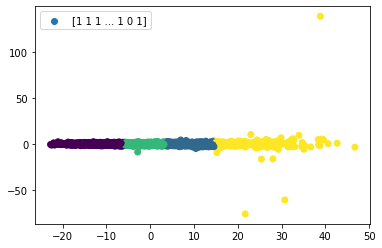

In [122]:
plt.scatter(
    PCA_Array.iloc[:, 0],
    PCA_Array.iloc[:, 1], 
c = kmeans_labels,
label = kmeans_labels)
plt.legend()

In [129]:
PCA_Array['filename'] = df_vector.iloc[:5000 , 0]

In [131]:
PCA_Array.head()

,0,1,2,Kmeans,filename
0,12.578550,0.920458,0.057439,1,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...
1,11.869090,-0.118117,0.768640,1,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...
2,10.814100,0.204790,-2.418845,1,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...
3,5.664127,-0.924818,-1.264272,1,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...
4,11.020013,-0.409427,-1.501890,1,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...


In [123]:
PCA_Array['Kmeans'] = kmeans_labels

nan


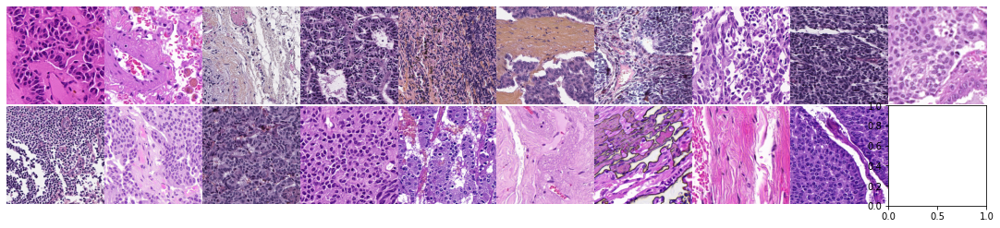

In [138]:
tiles_in_cluster(0, PCA_Array, ascending=True )

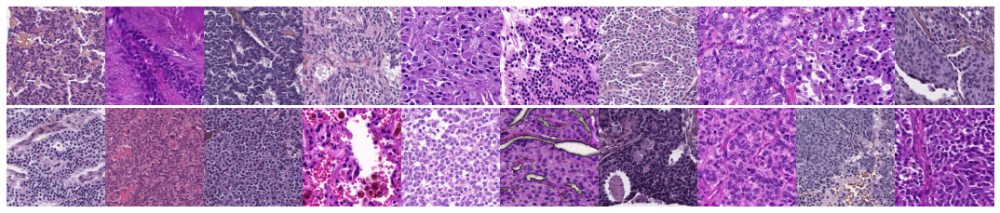

In [139]:
tiles_in_cluster(1, PCA_Array, ascending=True )

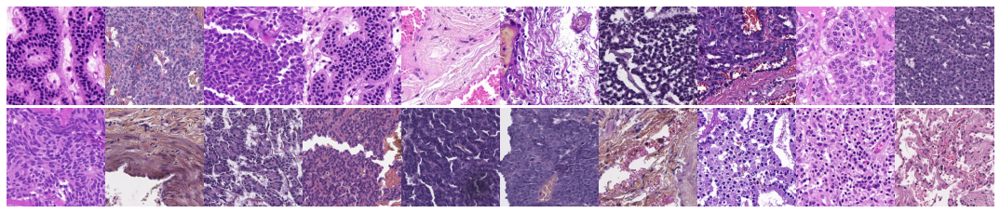

In [140]:
tiles_in_cluster(2, PCA_Array, ascending=True )

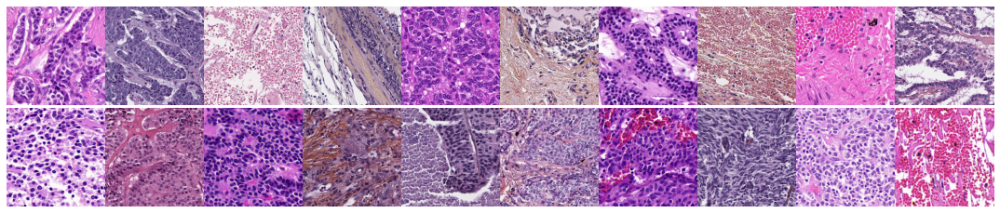

In [141]:
tiles_in_cluster(3, PCA_Array, ascending=True )

In [19]:
kmeans_labels = cluster.KMeans(n_clusters=4).fit_predict(embedding)

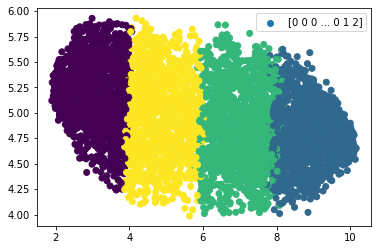

In [20]:
plt.scatter(
    embedding[:, 0],
    embedding[:, 1], 
c = kmeans_labels,
label = kmeans_labels)
plt.legend()

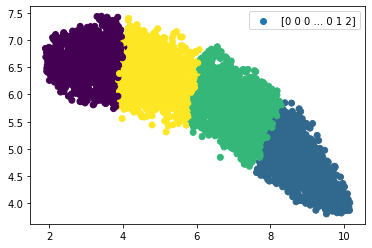

In [21]:
plt.scatter(
    embedding[:, 0],
    embedding[:, 2], 
c = kmeans_labels,
label = kmeans_labels)
plt.legend()

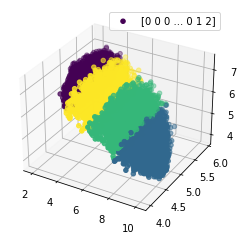

In [22]:
fig = plt.figure()
ax = plt.axes(projection='3d')
ax.scatter(
    embedding[:, 0],
    embedding[:, 1],
    embedding[:, 2], 
c = kmeans_labels,
label = kmeans_labels)
plt.legend()

In [25]:
embedding = pd.DataFrame(embedding)
embedding['filename'] = df_vector.iloc[:5000 , 0]


In [29]:
embedding['Kmeans'] = kmeans_labels

<AxesSubplot:xlabel='0', ylabel='1'>

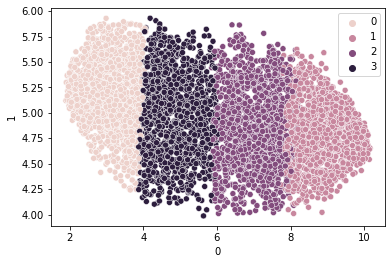

In [51]:
sns.scatterplot(x=embedding.iloc[:, 0], y=embedding.iloc[:, 1], hue=kmeans_labels)

In [24]:
 df_vector.iloc[:5000 , 0]

0       /gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...
1       /gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...
2       /gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...
3       /gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...
4       /gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...
                              ...                        
4995    /gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...
4996    /gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...
4997    /gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...
4998    /gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...
4999    /gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...
Name: 0, Length: 5000, dtype: object

In [137]:
def tiles_in_cluster(cluster_number , clustering_df, ascending=True ):
    '''clustering_df : contain filename '''
    clusteremd_x = clustering_df[clustering_df['Kmeans'] == cluster_number] # purple
    clusteremd_x = clusteremd_x.sort_values(by =  0,axis= 0, ascending=ascending) # left extremity purple
    # left extremity yellow cluster
    c  = 0 
    fig, axs = plt.subplots(2,10, figsize=(19, 4), facecolor='w', edgecolor='k')
    fig.subplots_adjust(hspace =0, wspace=0)
    row2 = False
    for ele in clusteremd_x['filename'][0:20]:
        try:
            im = cv2.imread(ele)
            im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
            if row2 == False:
                if c < 10:
                    axs[0,c].imshow(im)
                    axs[0,c].axis('off')
                    c+=1
                elif c == 10:
                    c = 0 
                    row2 = True
                    axs[1,c].imshow(im)
                    axs[1,c].axis('off')
                    c +=1

            else:
                axs[1,c].imshow(im)
                axs[1,c].axis('off')
                c+=1
        except:
            print(ele)


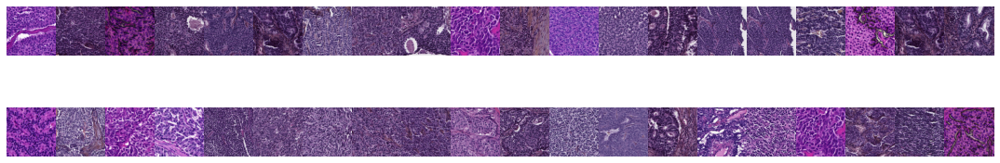

In [58]:
tiles_in_cluster(0, embedding, ascending=True )

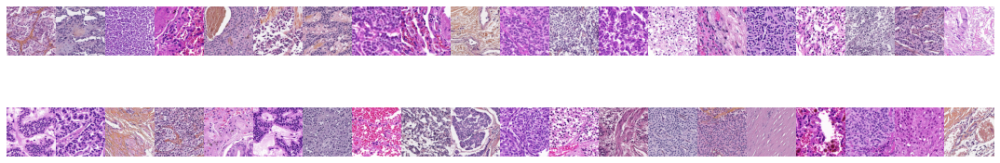

In [59]:
tiles_in_cluster(1, embedding, ascending=True )

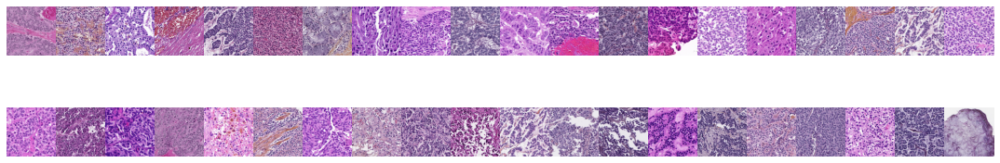

In [60]:
tiles_in_cluster(2, embedding, ascending=True )

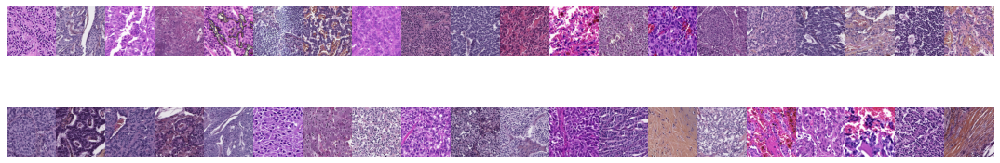

In [61]:
tiles_in_cluster(3, embedding, ascending=True )

In [62]:
embedding.head()

,0,1,2,filename,Kmeans
0,2.227801,5.492643,6.399400,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0
1,1.893718,5.120912,6.843998,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0
2,3.118551,4.575506,6.394810,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0
3,4.396820,5.520396,7.094026,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,3
4,2.962976,5.707006,7.016981,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0


## UMAP MU

In [87]:
df_umap = pd.read_csv(os.path.join(rootdir, 'umap_mu.csv'))
df_umap.shape

(282206, 5)

In [28]:
df_umap.head()

,Unnamed: 0,0,1,2,filename
0,0,10.034722,2.543240,10.647268,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...
1,1,9.602166,2.958158,10.162538,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...
2,2,9.428291,3.429079,10.577189,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...
3,3,9.530040,3.036659,11.259602,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...
4,4,9.918195,1.652149,10.515995,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...


In [29]:
kmeans = cluster.KMeans(n_clusters=1)
kmeans_labels = kmeans.fit_predict(df_umap.iloc[:,1:4])
centroids  = kmeans.cluster_centers_

In [30]:
plt.scatter(
    df_umap.iloc[:, 1],
    df_umap.iloc[:, 2], 
c = kmeans_labels,
label = kmeans_labels)
plt.legend()

<IPython.core.display.Javascript object>


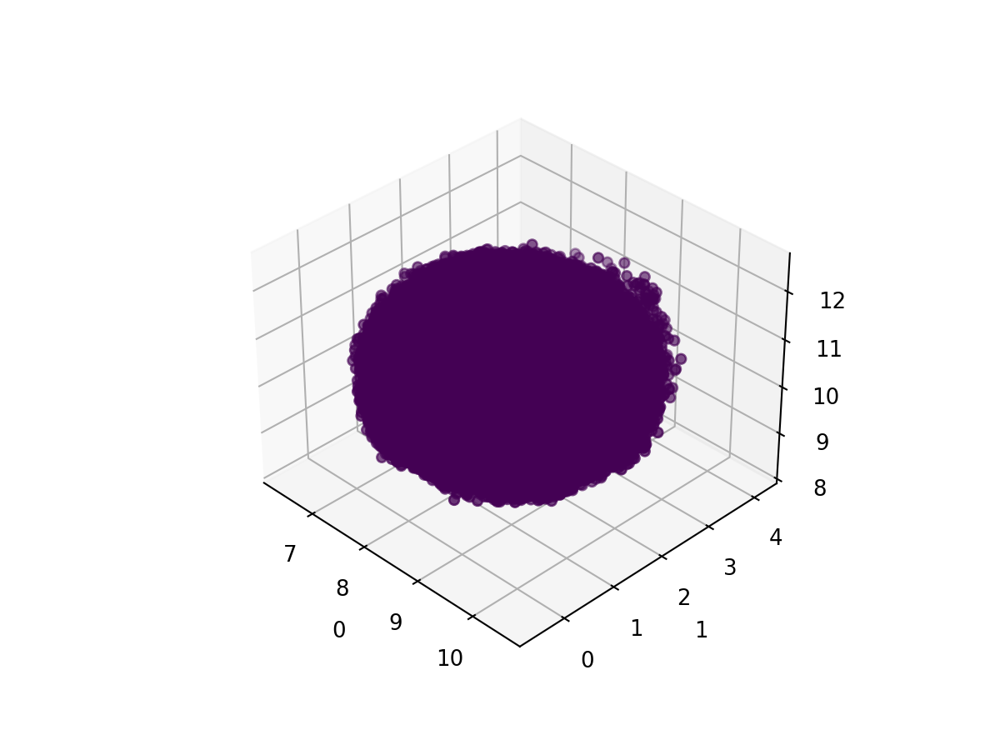

Text(0.5, 0, '1')

In [31]:
%matplotlib notebook
fig = plt.figure()
ax = plt.axes(projection='3d')
ax.scatter(
    df_umap.iloc[:, 1],
    df_umap.iloc[:, 2],
    df_umap.iloc[:, 3],
    c = kmeans_labels,
    label = kmeans_labels
)
ax.set_xlabel('0')
ax.set_ylabel('1')

In [32]:
import math
dist_centre_0 = []
df_umap['Kmeans'] = kmeans_labels
df_umap_0 = df_umap[df_umap['Kmeans'] == 0]
for i in range(df_umap_0.shape[0]):
    dist_centre_0.append(math.sqrt( (df_umap_0.iloc[i,1] - centroids[0,0]) **2 +
             (df_umap_0.iloc[i,2] - centroids[0,1]) **2 +
             (df_umap_0.iloc[i,3] - centroids[0,2]) **2
            ))

In [33]:
df_umap_0['distance_to_centroid'] = dist_centre_0

In [34]:
to_print_c0 = list(df_umap_0.sort_values(by ='distance_to_centroid',axis= 0, ascending=True)['filename'].values[0:20])

<IPython.core.display.Javascript object>


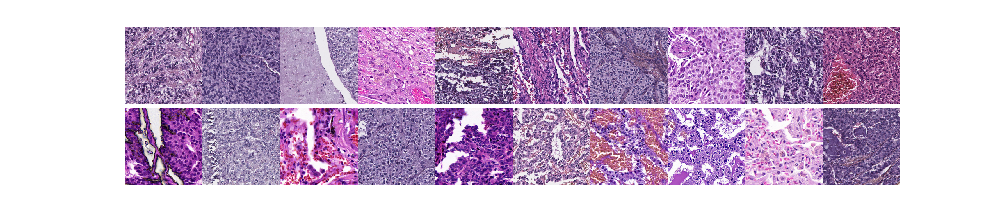

In [35]:
c  = 0 
fig, axs = plt.subplots(2,10, figsize=(19, 4), facecolor='w', edgecolor='k')
fig.subplots_adjust(hspace =0, wspace=0)
row2 = False
for ele in to_print_c0:
    try:
        im = cv2.imread(ele)
        im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
        if row2 == False:
            if c < 10:
                axs[0,c].imshow(im)
                axs[0,c].axis('off')
                c+=1
            elif c == 10:
                c = 0 
                row2 = True
                axs[1,c].imshow(im)
                axs[1,c].axis('off')
                c +=1

        else:
            axs[1,c].imshow(im)
            axs[1,c].axis('off')
            c+=1
    except:
        print(ele)


In [15]:
df_umap['filename'][0]

'/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_1802/Tiles_512_512_1802/TNE0563/accept/TNE0563_14323_103951.jpg'

In [53]:
sample = []
for i in range(df_umap.shape[0]):
    sample.append(df_umap['filename'][i].split('/')[-3])
df_umap['sample'] = sample

In [54]:
df_umap.head()

,Unnamed: 0,0,1,2,filename,Kmeans,sample
0,0,10.034722,2.543240,10.647268,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0,TNE0563
1,1,9.602166,2.958158,10.162538,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0,TNE0568
2,2,9.428291,3.429079,10.577189,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0,TNE1003
3,3,9.530040,3.036659,11.259602,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0,TNE1418
4,4,9.918195,1.652149,10.515995,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0,TNE0485


In [55]:
df_umap_TNE0417  = df_umap[df_umap['sample'] == 'TNE0563']

<IPython.core.display.Javascript object>


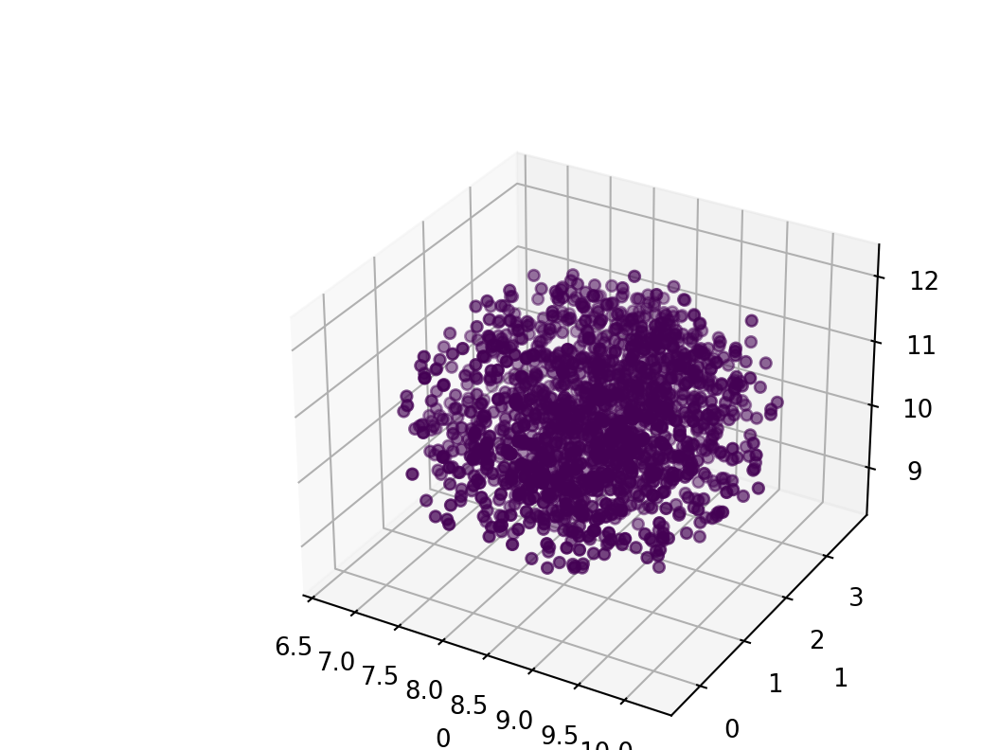

Text(0.5, 0, '1')

In [56]:
%matplotlib notebook

kmeans = cluster.KMeans(n_clusters=1)
kmeans_labels = kmeans.fit_predict(df_umap_TNE0417.iloc[:,1:4])
centroids  = kmeans.cluster_centers_

fig = plt.figure()
ax = plt.axes(projection='3d')
ax.scatter(
    df_umap_TNE0417.iloc[:, 1],
    df_umap_TNE0417.iloc[:, 2],
    df_umap_TNE0417.iloc[:, 3],
    c = kmeans_labels,
    label = kmeans_labels
)
ax.set_xlabel('0')
ax.set_ylabel('1')

In [57]:
df_umap_TNE0417.head()

,Unnamed: 0,0,1,2,filename,Kmeans,sample
0,0,10.034722,2.543240,10.647268,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0,TNE0563
19,19,8.998334,2.922565,11.470580,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0,TNE0563
440,440,8.240717,1.291722,12.106331,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0,TNE0563
560,560,9.659790,2.855030,11.676299,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0,TNE0563
645,645,7.936287,1.940942,11.995611,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0,TNE0563


In [58]:
centroids

array([[ 8.4539427 ,  1.82867967, 10.34215065]])

In [59]:
import math
dist_centre_0 = []
df_umap_TNE0417['Kmeans'] = kmeans_labels
df_umap_TNE0417_0 = df_umap_TNE0417[df_umap_TNE0417['Kmeans'] == 0]
for i in range(df_umap_TNE0417.shape[0]):
    dist_centre_0.append(math.sqrt( (df_umap_TNE0417_0.iloc[i,1] - centroids[0,0]) **2 +
             (df_umap_TNE0417_0.iloc[i,2] - centroids[0,1]) **2 +
             (df_umap_TNE0417_0.iloc[i,3] - centroids[0,2]) **2
            ))

/gpfslocalsup/pub/anaconda-py3/2020.02/envs/pytorch-gpu-1.7.0/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [62]:
df_umap_TNE0417_0['distance_to_centroid'] = dist_centre_0

<IPython.core.display.Javascript object>


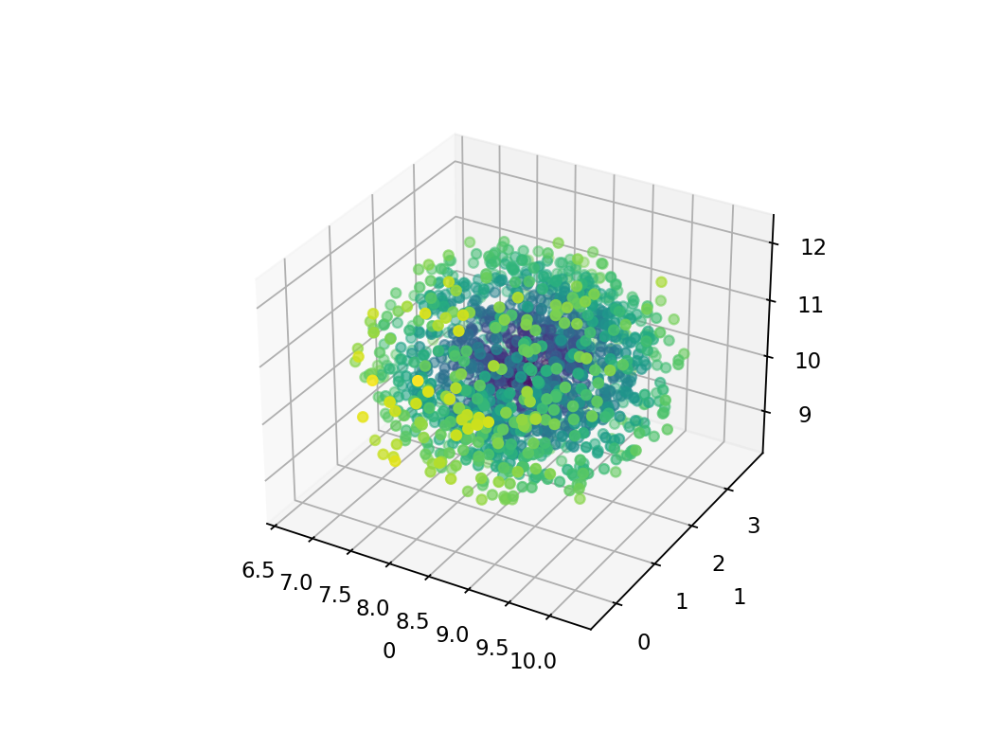

Text(0.5, 0, '1')

In [63]:

fig = plt.figure()
ax = plt.axes(projection='3d')
ax.scatter(
    df_umap_TNE0417.iloc[:, 1],
    df_umap_TNE0417.iloc[:, 2],
    df_umap_TNE0417.iloc[:, 3],
    c = df_umap_TNE0417_0['distance_to_centroid'] 
)
ax.set_xlabel('0')
ax.set_ylabel('1')

In [ ]:

fig = plt.figure()
ax = plt.axes(projection='3d')
ax.scatter(
    df_umap_TNE0417.iloc[:, 1],
    df_umap_TNE0417.iloc[:, 2],
    df_umap_TNE0417.iloc[:, 3],
    c = df_umap_TNE0417_0['distance_to_centroid'] 
)
ax.set_xlabel('0')
ax.set_ylabel('1')

In [43]:
x = []
y = []
sample_test = []
for i in range(df_umap_TNE0417_0.shape[0]):
    filen = df_umap_TNE0417_0.iloc[i,4]
    sample_c = df_umap_TNE0417_0.iloc[i,6]
    x_c = int(filen.split('/')[-1].split('_')[1])
    
    try:
        y_c = int(filen.split('/')[-1].split('_')[-1].split('.')[0])
    except:
        if filen.split('/')[-1].split('_')[-1].split('.')[0].find('flip') != -1:
            y_c = int(filen.split('/')[-1].split('_')[-1].split('.')[0].split('flip')[0])
        else:
            y_c = int(filen.split('/')[-1].split('_')[-1].split('.')[0].split('rotated')[0])
    sample_test.append(sample_c)
    x.append(x_c)
    y.append(y_c)
df_umap_TNE0417_0['x'] = x
df_umap_TNE0417_0['y'] = y

<IPython.core.display.Javascript object>


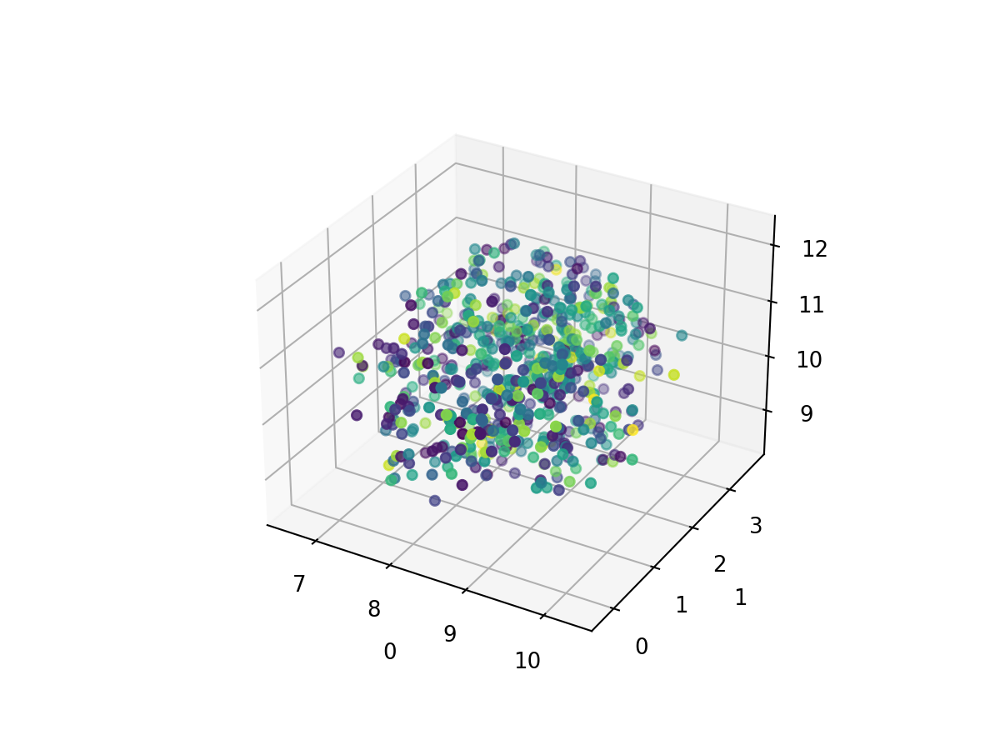

Text(0.5, 0, '1')

In [46]:
fig = plt.figure()
ax = plt.axes(projection='3d')
ax.scatter(
    df_umap_TNE0417.iloc[:, 1],
    df_umap_TNE0417.iloc[:, 2],
    df_umap_TNE0417.iloc[:, 3],
    c = df_umap_TNE0417_0['x'] 
)
ax.set_xlabel('0')
ax.set_ylabel('1')

In [44]:
df_umap_TNE0417_0.head()

,Unnamed: 0,0,1,2,filename,Kmeans,sample,distance_to_centroid,x,y
349,349,10.332514,1.951594,10.855024,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0,TNE0417,1.943080,90553,60061
375,375,9.862547,1.692986,11.091768,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0,TNE0417,1.567242,21253,52669
799,799,9.378242,2.268074,11.987201,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0,TNE0417,1.926221,60061,19405
995,995,8.076143,1.010386,11.364468,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0,TNE0417,1.260291,23101,56365
1342,1342,8.766167,0.017012,10.393239,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0,TNE0417,1.717654,76693,36037


In [41]:
df_umap_TNE0417.head()

,Unnamed: 0,0,1,2,filename,Kmeans,sample
349,349,10.332514,1.951594,10.855024,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0,TNE0417
375,375,9.862547,1.692986,11.091768,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0,TNE0417
799,799,9.378242,2.268074,11.987201,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0,TNE0417
995,995,8.076143,1.010386,11.364468,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0,TNE0417
1342,1342,8.766167,0.017012,10.393239,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0,TNE0417


In [23]:
df_umap_TNE0417_0['distance_to_centroid'] = dist_centre_0

In [24]:
to_print_c0 = list(df_umap_TNE0417_0.sort_values(by ='distance_to_centroid',axis= 0, ascending=True)['filename'].values[0:20])

<IPython.core.display.Javascript object>


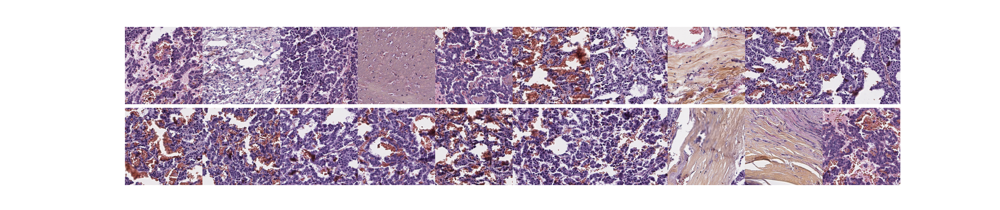

In [25]:
df_umap_TNE0417_0['distance_to_centroid'] = dist_centre_0
to_print_c0 = list(df_umap_TNE0417_0.sort_values(by ='distance_to_centroid',axis= 0, ascending=True)['filename'].values[0:20])
c  = 0 
fig, axs = plt.subplots(2,10, figsize=(19, 4), facecolor='w', edgecolor='k')
fig.subplots_adjust(hspace =0, wspace=0)
row2 = False
for ele in to_print_c0:
    try:
        im = cv2.imread(ele)
        im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
        if row2 == False:
            if c < 10:
                axs[0,c].imshow(im)
                axs[0,c].axis('off')
                c+=1
            elif c == 10:
                c = 0 
                row2 = True
                axs[1,c].imshow(im)
                axs[1,c].axis('off')
                c +=1

        else:
            axs[1,c].imshow(im)
            axs[1,c].axis('off')
            c+=1
    except:
        print(ele)


In [26]:
df_umap_TNE0417_0['distance_to_centroid'] = dist_centre_0
to_print_c0 = list(df_umap_TNE0417_0.sort_values(by ='distance_to_centroid',axis= 0, ascending=False)['filename'].values[0:20])
c  = 0 
fig, axs = plt.subplots(2,10, figsize=(19, 4), facecolor='w', edgecolor='k')
fig.subplots_adjust(hspace =0, wspace=0)
row2 = False
for ele in to_print_c0:
    try:
        im = cv2.imread(ele)
        im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
        if row2 == False:
            if c < 10:
                axs[0,c].imshow(im)
                axs[0,c].axis('off')
                c+=1
            elif c == 10:
                c = 0 
                row2 = True
                axs[1,c].imshow(im)
                axs[1,c].axis('off')
                c +=1

        else:
            axs[1,c].imshow(im)
            axs[1,c].axis('off')
            c+=1
    except:
        print(ele)


<IPython.core.display.Javascript object>

In [36]:
df_umap_TNE0417_0.head()

,Unnamed: 0,0,1,2,filename,Kmeans,sample,distance_to_centroid
349,349,10.332514,1.951594,10.855024,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0,TNE0417,1.943080
375,375,9.862547,1.692986,11.091768,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0,TNE0417,1.567242
799,799,9.378242,2.268074,11.987201,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0,TNE0417,1.926221
995,995,8.076143,1.010386,11.364468,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0,TNE0417,1.260291
1342,1342,8.766167,0.017012,10.393239,/gpfsscratch/rech/ohv/ueu39kt/Tiles_512_512_18...,0,TNE0417,1.717654


In [64]:
df_umap_TNE0417_0.to_csv(os.path.join(rootdir, 'TumorNoTumor_VTADL_MDN_UMAP_TNE0563.csv'))